In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import matplotlib.pyplot as plt
%matplotlib inline
import numpy as np
import pandas as pd
import sys
np.set_printoptions(threshold=sys.maxsize)

In [3]:
from cassandra.cluster import Cluster
from os.path import expanduser
home = expanduser("~")
with open(home+'/.aws/cassandra_cluster') as f:
    cluster_ip = f.readline().strip('\n')
cluster = Cluster([cluster_ip])
session = cluster.connect('measurements')

In [4]:
from solardatatools import standardize_time_axis, make_2d, plot_2d, fix_time_shifts
from statistical_clear_sky.utilities.data_conversion import make_time_series

In [5]:
import time

In [6]:
cql_first_part = "select site, meas_name, ts, sensor, meas_val_f from measurement_raw "
cql_last_part = "and meas_name = 'ac_power';"

In [7]:
from sys import path
path.append('..')
from solar_data_pipeline.database.cassandra import CassandraDataAccess

In [9]:
data_access = CassandraDataAccess(cluster_ip)
sites = data_access.get_sites()

In [10]:
number_of_sites = 4
number_of_days_per_site = 10

In [19]:
selected_sites = np.random.choice(sites, number_of_sites)
selected_sites

array(['TADCC1021403', 'TAEKC1078620', 'TADBC1078234', 'TADBC1077995'],
      dtype='<U19')

In [20]:
import functools

In [21]:
cql_sites_string = functools.reduce(lambda result_string, site:
               result_string + ", '" + site + "'" ,
               selected_sites, "")[2:]
cql_sites_string

"'TADCC1021403', 'TAEKC1078620', 'TADBC1078234', 'TADBC1077995'"

In [22]:
cql_where_clause = "where site in (" + cql_sites_string + ")"
cql_where_clause

"where site in ('TADCC1021403', 'TAEKC1078620', 'TADBC1078234', 'TADBC1077995')"

In [23]:
cql = cql_first_part + cql_where_clause + cql_last_part
cql

"select site, meas_name, ts, sensor, meas_val_f from measurement_raw where site in ('TADCC1021403', 'TAEKC1078620', 'TADBC1078234', 'TADBC1077995')and meas_name = 'ac_power';"

In [25]:
execution_start_time = time.time()

rows = session.execute(cql)
data_frame = pd.DataFrame(list(rows))

execution_end_time = time.time()

print("Query execution time: %s" % (execution_end_time - execution_start_time))

Query execution time: 138.15072512626648


In [ ]:
# ti = time.time()
# data_frame.replace(-999999.0, np.NaN, inplace=True)
# tf = time.time()
# print("Query execution time: %s" % (tf - ti))

In [26]:
data_frame

,site,meas_name,ts,sensor,meas_val_f
0,TADBC1077995,ac_power,2015-03-18 17:55:00,839216975_FRONIUS IG XXXX,1.5260
1,TADBC1077995,ac_power,2015-03-18 17:55:00,839216977_FRONIUS IG XXXX,2.4650
2,TADBC1077995,ac_power,2015-03-18 18:00:00,839216975_FRONIUS IG XXXX,1.7714
3,TADBC1077995,ac_power,2015-03-18 18:00:00,839216977_FRONIUS IG XXXX,2.7582
4,TADBC1077995,ac_power,2015-03-18 18:05:00,839216975_FRONIUS IG XXXX,1.8719
5,TADBC1077995,ac_power,2015-03-18 18:05:00,839216977_FRONIUS IG XXXX,2.9941
6,TADBC1077995,ac_power,2015-03-18 18:10:00,839216975_FRONIUS IG XXXX,1.9590
7,TADBC1077995,ac_power,2015-03-18 18:10:00,839216977_FRONIUS IG XXXX,3.1578
8,TADBC1077995,ac_power,2015-03-18 18:15:00,839216975_FRONIUS IG XXXX,2.0038
9,TADBC1077995,ac_power,2015-03-18 18:15:00,839216977_FRONIUS IG XXXX,3.2001


In [27]:
data_frame_list = [data_frame.loc[data_frame['site'] == site] for site in selected_sites]
data_frame_list

[                 site meas_name                  ts  \
 1238990  TADCC1021403  ac_power 2017-06-05 21:05:00   
 1238991  TADCC1021403  ac_power 2017-06-05 21:10:00   
 1238992  TADCC1021403  ac_power 2017-06-05 21:15:00   
 1238993  TADCC1021403  ac_power 2017-06-05 21:20:00   
 1238994  TADCC1021403  ac_power 2017-06-05 21:30:00   
 1238995  TADCC1021403  ac_power 2017-06-05 21:35:00   
 1238996  TADCC1021403  ac_power 2017-06-05 21:40:00   
 1238997  TADCC1021403  ac_power 2017-06-05 21:45:00   
 1238998  TADCC1021403  ac_power 2017-06-05 21:50:00   
 1238999  TADCC1021403  ac_power 2017-06-05 21:55:00   
 1239000  TADCC1021403  ac_power 2017-06-05 22:00:00   
 1239001  TADCC1021403  ac_power 2017-06-05 22:05:00   
 1239002  TADCC1021403  ac_power 2017-06-05 22:10:00   
 1239003  TADCC1021403  ac_power 2017-06-05 22:15:00   
 1239004  TADCC1021403  ac_power 2017-06-05 22:20:00   
 1239005  TADCC1021403  ac_power 2017-06-05 22:25:00   
 1239006  TADCC1021403  ac_power 2017-06-05 22:3

In [29]:
len(data_frame_list)

4

In [28]:
time_series_data_frame_list = [make_time_series(data_frame, return_keys=False) for data_frame in data_frame_list if data_frame.shape[0] > 0]
# time_series_data_frame_list = [make_time_series(data_frame, return_keys=False) for data_frame in data_frame_list]
time_series_data_frame_list

/Users/tadatoshi/.pyenv/versions/anaconda3-2018.12/lib/python3.6/site-packages/statistical_clear_sky/utilities/data_conversion.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  df.sort_values('ts', inplace=True)
/Users/tadatoshi/.pyenv/versions/anaconda3-2018.12/lib/python3.6/site-packages/statistical_clear_sky/utilities/data_conversion.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  df.sort_values('ts', inplace=True)
/Users/tadatoshi/.pyenv/versions/anaconda3-2018.12/lib/python3.6/site-packages/statistical_clear_sky/utilities/data_conversion.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See 

[                     ac_power_01
 2017-06-05 13:05:00       3.9351
 2017-06-05 13:10:00       3.9270
 2017-06-05 13:15:00       3.4353
 2017-06-05 13:20:00       3.9817
 2017-06-05 13:25:00          NaN
 2017-06-05 13:30:00       3.7621
 2017-06-05 13:35:00       3.8419
 2017-06-05 13:40:00       2.8605
 2017-06-05 13:45:00       2.4882
 2017-06-05 13:50:00       3.5962
 2017-06-05 13:55:00       3.5720
 2017-06-05 14:00:00       3.1596
 2017-06-05 14:05:00       2.9598
 2017-06-05 14:10:00       3.5224
 2017-06-05 14:15:00       3.1203
 2017-06-05 14:20:00       3.3493
 2017-06-05 14:25:00       3.0824
 2017-06-05 14:30:00       2.7591
 2017-06-05 14:35:00       3.0508
 2017-06-05 14:40:00       2.9340
 2017-06-05 14:45:00       2.9883
 2017-06-05 14:50:00       2.2613
 2017-06-05 14:55:00       2.3090
 2017-06-05 15:00:00       2.0710
 2017-06-05 15:05:00       2.4227
 2017-06-05 15:10:00       2.7667
 2017-06-05 15:15:00       2.6754
 2017-06-05 15:20:00       2.3792
 2017-06-05 15

In [29]:
len(time_series_data_frame_list)

4

In [30]:
standardized_data_frame_list = [standardize_time_axis(time_series_data_frame) for time_series_data_frame in time_series_data_frame_list]
standardized_data_frame_list

[                     ac_power_01
 2017-06-05 00:00:00          NaN
 2017-06-05 00:05:00          NaN
 2017-06-05 00:10:00          NaN
 2017-06-05 00:15:00          NaN
 2017-06-05 00:20:00          NaN
 2017-06-05 00:25:00          NaN
 2017-06-05 00:30:00          NaN
 2017-06-05 00:35:00          NaN
 2017-06-05 00:40:00          NaN
 2017-06-05 00:45:00          NaN
 2017-06-05 00:50:00          NaN
 2017-06-05 00:55:00          NaN
 2017-06-05 01:00:00          NaN
 2017-06-05 01:05:00          NaN
 2017-06-05 01:10:00          NaN
 2017-06-05 01:15:00          NaN
 2017-06-05 01:20:00          NaN
 2017-06-05 01:25:00          NaN
 2017-06-05 01:30:00          NaN
 2017-06-05 01:35:00          NaN
 2017-06-05 01:40:00          NaN
 2017-06-05 01:45:00          NaN
 2017-06-05 01:50:00          NaN
 2017-06-05 01:55:00          NaN
 2017-06-05 02:00:00          NaN
 2017-06-05 02:05:00          NaN
 2017-06-05 02:10:00          NaN
 2017-06-05 02:15:00          NaN
 2017-06-05 02

In [31]:
len(standardized_data_frame_list)

4

In [32]:
power_matrix_list = [make_2d(standardized_data_frame, key='ac_power_01',
            zero_nighttime=True, interp_missing=True) for standardized_data_frame in standardized_data_frame_list]

In [33]:
power_matrix_list

[array([[0.        , 0.        , 0.        , 0.        , 0.        ,
         0.        , 0.        , 0.        , 0.        , 0.        ,
         0.        , 0.        , 0.        , 0.        , 0.        ,
         0.        , 0.        , 0.        , 0.        , 0.        ,
         0.        , 0.        , 0.        , 0.        , 0.        ,
         0.        , 0.        , 0.        , 0.        , 0.        ,
         0.        , 0.        , 0.        , 0.        , 0.        ,
         0.        , 0.        , 0.        , 0.        , 0.        ,
         0.        , 0.        , 0.        , 0.        , 0.        ,
         0.        , 0.        , 0.        , 0.        , 0.        ,
         0.        , 0.        , 0.        , 0.        , 0.        ,
         0.        , 0.        , 0.        , 0.        , 0.        ,
         0.        , 0.        , 0.        , 0.        , 0.        ,
         0.        , 0.        , 0.        , 0.        , 0.        ,
         0.        , 0.        , 0

In [34]:
len(power_matrix_list)

4

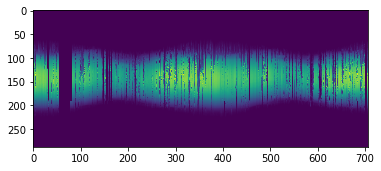

In [35]:
plt.imshow(power_matrix_list[0])

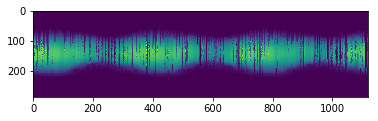

In [36]:
plt.imshow(power_matrix_list[1])

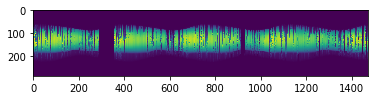

In [37]:
plt.imshow(power_matrix_list[2])

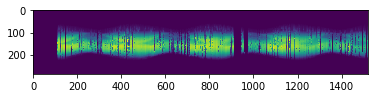

In [38]:
plt.imshow(power_matrix_list[3])

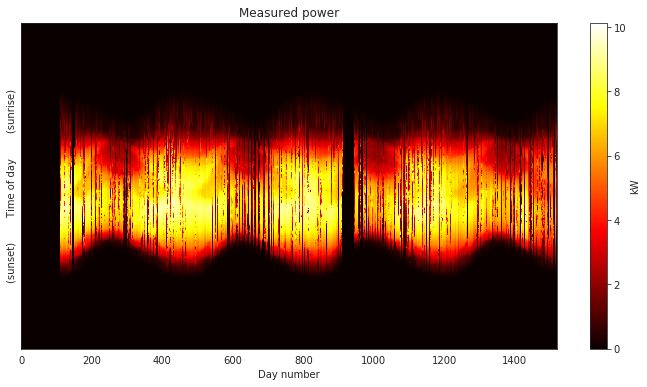

In [39]:
fig = plot_2d(power_matrix_list[3])

In [97]:
selected_power_list = []

for power_matrix in power_matrix_list:
    day_candidates = power_matrix.shape[1]
    selected_days = np.random.choice(day_candidates, number_of_days_per_site)
    
    for selected_day in selected_days:
        selected_power_list.append(power_matrix[:,selected_day])
        
selected_power_array = np.array(selected_power_list)

In [98]:
selected_power_array.shape

(40, 288)

In [99]:
selected_power_array

array([[ 0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.013     ,  0.026     ,  0.0427    ,
         0.0703    ,  0.0876    ,  0.0962    ,  0.1

In [100]:
selected_power_matrix = selected_power_array.T
selected_power_matrix

array([[ 0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ],
       [ 0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.        ,  0.        ,
         0.        ,  0.        ,  0.        ,  0.

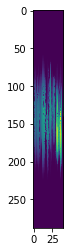

In [101]:
plt.imshow(selected_power_matrix)